In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import calendar
import warnings
warnings.filterwarnings("ignore")

from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [2]:
# First of all we download  our dataset from the seaborn python library dataset
# Then, we add a 'date' column joining together 'year' and 'month'. We need it for plots.

df = sns.load_dataset("flights")

# Create a 'date' y-m-d column 
months = pd.to_datetime(df.month, format='%b').dt.month
df['date'] = pd.to_datetime(dict(year=df.year, month=months, day=1))
df = df[['date', 'year', 'month', 'passengers']]
df

,date,year,month,passengers
0,1949-01-01,1949,Jan,112
1,1949-02-01,1949,Feb,118
2,1949-03-01,1949,Mar,132
3,1949-04-01,1949,Apr,129
4,1949-05-01,1949,May,121
...,...,...,...,...
139,1960-08-01,1960,Aug,606
140,1960-09-01,1960,Sep,508
141,1960-10-01,1960,Oct,461
142,1960-11-01,1960,Nov,390


In [3]:
# Order months chronologically as opposed to alphabetically
months_categories = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
df["month"] = pd.Categorical(df["month"], categories = months_categories)

# Check results
df

,date,year,month,passengers
0,1949-01-01,1949,Jan,112
1,1949-02-01,1949,Feb,118
2,1949-03-01,1949,Mar,132
3,1949-04-01,1949,Apr,129
4,1949-05-01,1949,May,121
...,...,...,...,...
139,1960-08-01,1960,Aug,606
140,1960-09-01,1960,Sep,508
141,1960-10-01,1960,Oct,461
142,1960-11-01,1960,Nov,390


# 
### Time series analysis involves visuals checks.
####  
#### First of all we want to know whether the time series is stationary. That is, whether it has constant mean and constant variance.

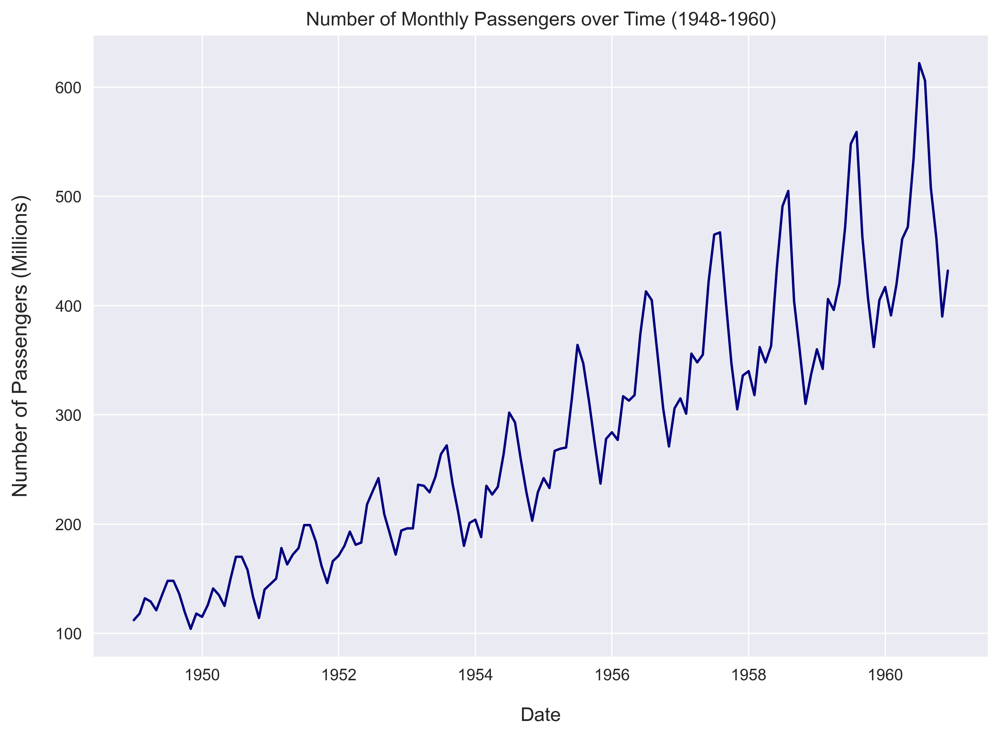

In [4]:
sns.set_style('darkgrid')
plt.figure(figsize=(10,7), dpi=400)
sns.lineplot(data=df, x='date', y='passengers', color='navy')
plt.ylabel('Number of Passengers (Millions)', size=13, labelpad=15)
plt.xlabel('Date', size=12, labelpad=15)
plt.title('Number of Monthly Passengers over Time (1948-1960)', size=12)

plt.show()

### Clearly, it is not stationary. It has a growing trend and a seasonal component.
### 
### We can see each component, trend and seasonality, separated from each other in the following two plots.

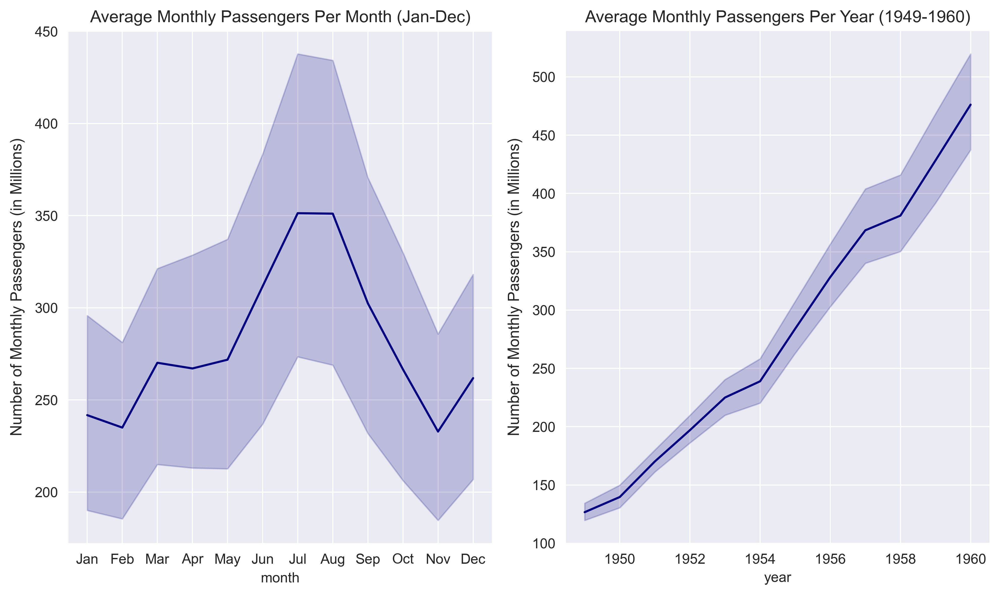

In [5]:
plt.figure(figsize=(10,6), dpi=400)

plt.subplot(1,2,1)
sns.lineplot(data=df, x='month', y='passengers', color='navy')
plt.ylabel('Number of Monthly Passengers (in Millions)', size=11, labelpad=7)
plt.title('Average Monthly Passengers Per Month (Jan-Dec)')

plt.subplot(1,2,2)
sns.lineplot(data=df, x='year', y='passengers', color='navy')
plt.ylabel('Number of Monthly Passengers (in Millions)', size=11, labelpad=7)
plt.title('Average Monthly Passengers Per Year (1949-1960)')


plt.tight_layout()
plt.show()

#### The plot on the left represents the seasonal component, the one on the right, the trend component. The first one shows the "average" Jan, Feb, etc. from 1949 to 1960. The second shows the "average" month in 1949, 1950, etc.
# 

### Now, we'll pass the original series, the monthly differentiated series and the monthly & yearly differentiated series through the Augmented Dickey-Fuller and Kwiatkowski-Phillips-Schmidt-Shin tests

In [6]:
# Put the series through the Augmented Dickey-Fuller test

print(('Augmented Dickey-Fuller Test').upper(), '\n'
      'Null Hypothesis: There is NO Stationarity', '\n')
# Serie original sin transformar
result = adfuller(df.passengers.dropna())
print('ADF Statistic: %f' % result[0])
if result[1] >= 0.05:
    print('p-value: %f' % result[1], '\n'
          'H0 is not rejected', '\n'
          '*** The series is NOT stationary ***')
else:
    print('p-value: %f' % result[1], '\n'
          'H0 is rejectected', '\n'
          '*** The series IS stationary ***')
print()

# Serie diferenciada mensualmente
result = adfuller(df.passengers.diff().dropna())
print('ADF Statistic: %f' % result[0])
if result[1] >= 0.05:
    print('p-value: %f' % result[1], '\n'
          'H0 is not rejected', '\n'
          '*** The differentiated series is NOT stationary ***')
else:
    print('p-value: %f' % result[1], '\n'
          'H0 is rejected', '\n'
          '*** The differentiated series IS stationary ***')
print()

# Serie diferenciada por mes y año
result = adfuller(df.passengers.diff().diff(periods=12).dropna())
print('ADF Statistic: %f' % result[0])
if result[1] >= 0.05:
    print('p-value: %f' % result[1], '\n'
          'H0 is not rejected', '\n'
          '*** The series differentiated monthly and yearly is NOT stationary ***')
else:
    print('p-value: %f' % result[1], '\n'
          'H0 is rejected', '\n'
          '*** The series differentiated monthly and yearly IS stationary ***')

AUGMENTED DICKEY-FULLER TEST 
Null Hypothesis: There is NO Stationarity 

ADF Statistic: 0.815369
p-value: 0.991880 
H0 is not rejected 
*** The series is NOT stationary ***

ADF Statistic: -2.829267
p-value: 0.054213 
H0 is not rejected 
*** The differentiated series is NOT stationary ***

ADF Statistic: -15.595618
p-value: 0.000000 
H0 is rejected 
*** The series differentiated monthly and yearly IS stationary ***


In [7]:
# Put the series through the Kwiatkowski-Phillips-Schmidt-Shin Test

print(('Kwiatkowski-Phillips-Schmidt-Shin Test').upper(), '\n',
      'Null Hypothesis: There IS stationarity', '\n')
# Serie original sin transformar
result = kpss(df.passengers.dropna())
print('KPSS Statistic: %f' % result[0])
if result[1] < 0.05:
    print('p-value: %f' % result[1], '\n'
          'H0 is rejected', '\n'
          '*** The series is NOT stationary ***')
else:
    print('p-value: %f' % result[1], '\n'
          'H0 is not rejected', '\n'
          '*** The series IS stationary ***')
print()

# monthly differentiated series
result = kpss(df.passengers.diff().dropna())
print('KPSS Statistic: %f' % result[0])
if result[1] < 0.05:
    print('p-value: %f' % result[1], '\n'
          'H0 is rejected', '\n'
          '*** The differentiated series is NOT stationary ***')
else:
    print('p-value: %f' % result[1], '\n'
          'H0 is not rejected', '\n'
          '*** The differentiated series IS stationary ***')
print()

# monthly & yearly differentiated series
result = kpss(df.passengers.diff().diff(periods=12).dropna())
print('KPSS Statistic: %f' % result[0])
if result[1] < 0.05:
    print('p-value: %f' % result[1], '\n'
          'H0 is rejected', '\n'
          '*** The series differentiated monthly and yearly is NOT stationary ***')
else:
    print('p-value: %f' % result[1], '\n'
          'H0 is not rejected', '\n'
          '*** The series differentiated monthly and yearly IS stationary ***')
print()

KWIATKOWSKI-PHILLIPS-SCHMIDT-SHIN TEST 
 Null Hypothesis: There IS stationarity 

KPSS Statistic: 1.651312
p-value: 0.010000 
H0 is rejected 
*** The series is NOT stationary ***

KPSS Statistic: 0.023898
p-value: 0.100000 
H0 is not rejected 
*** The differentiated series IS stationary ***

KPSS Statistic: 0.046774
p-value: 0.100000 
H0 is not rejected 
*** The series differentiated monthly and yearly IS stationary ***



#### As expected, both tests confirm the original series is not stationary. They both also conclude the monthly and yearly differentiated series is stationary. They raise, however, some doubts regarding the monthly differentiated series, the ADF test says is not, while the KPSS says it is. 
# 
### To figure it out, we'll make a visual test.

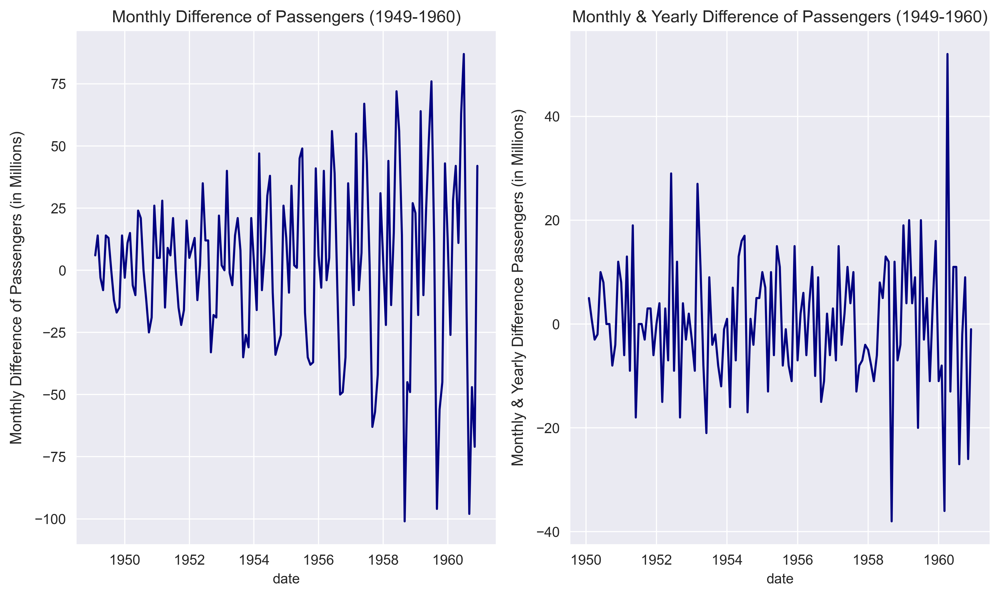

In [8]:
# Define variables
df['m_diff'] = df.passengers.diff().dropna()
df['m_y_diff'] = df.passengers.diff().diff(periods=12).dropna()

# Define subplots and their contents
plt.figure(figsize=(10,6), dpi=400)
plt.subplot(1,2,1)
sns.lineplot(data=df, x='date', y='m_diff', color='navy')
plt.ylabel('Monthly Difference of Passengers (in Millions)', size=11, labelpad=7)
plt.title('Monthly Difference of Passengers (1949-1960)')

plt.subplot(1,2,2)
sns.lineplot(data=df, x='date', y='m_y_diff', color='navy')
plt.ylabel('Monthly & Yearly Difference Passengers (in Millions)', size=11, labelpad=7)
plt.title('Monthly & Yearly Difference of Passengers (1949-1960)')

plt.tight_layout()
plt.show()

#### The results are clear: the time series on the left cannot be stationary, it has a growing variance while it retains some of the seasonality pattern. The series on the right, on the other hand, comes close to being ideally stationary. Therefore, we're gonna use it for our predicting models.
# 


### To finish up the time series comparison, we contrast two heatmaps, one corresponding to the original series, the other to the stationary series.

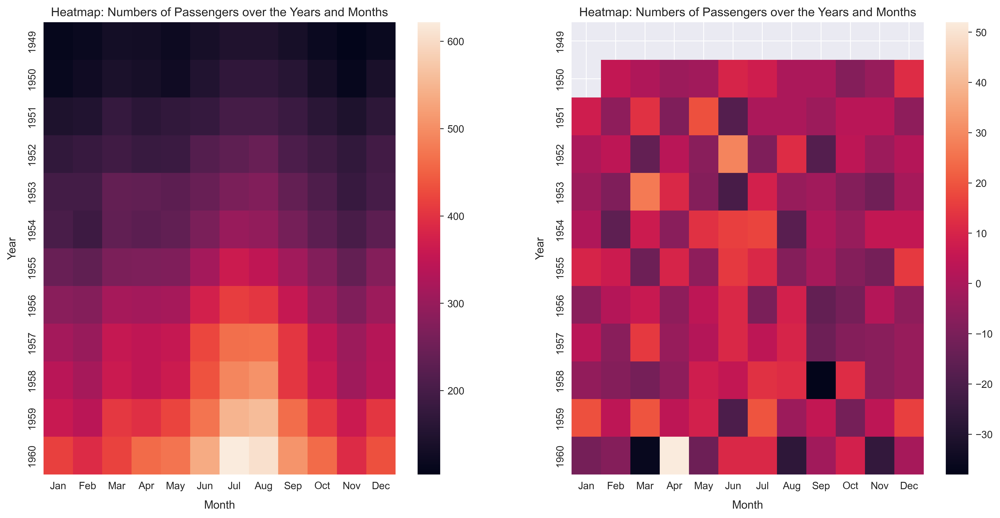

In [9]:
plt.figure(figsize=(17,8), dpi=400)

plt.subplot(1,2,1)
hm = df.pivot(index="year", columns="month", values="passengers")
sns.heatmap(hm)
plt.title('Heatmap: Numbers of Passengers over the Years and Months', size=12)
plt.xlabel('Month', size=11, labelpad=9)
plt.ylabel('Year', size=11, labelpad=9)

plt.subplot(1,2,2)
hm = df.pivot(index="year", columns="month", values="m_y_diff")
sns.heatmap(hm)
plt.title('Heatmap: Numbers of Passengers over the Years and Months', size=12)
plt.xlabel('Month', size=11, labelpad=9)
plt.ylabel('Year', size=11, labelpad=9)

plt.show()

#### An interesting thing is happening here: the heatmap on the left shows a clear patern, kinda like a pixelated bonfire, whereas the plot on the right shows something closer to white noise. This, again, argues the original series is not stationary as opposed to the series differentiated monthly & yearly.
# 

## Cross Validation
# 
### Training and Test sets 

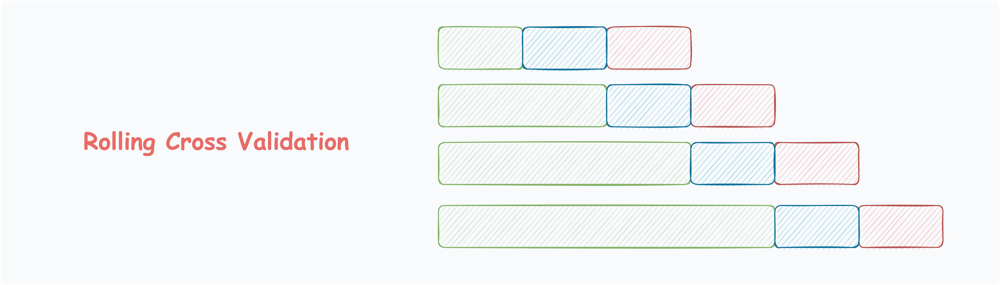

#
#### We will use train and test sets. Looking to the pic above that's green and blue rectangles only.
#### Only three splits (four folds). As we have 144 rows, it implies test sets of 36 obs (3 years). 
#### Three train sets lenghts: 1/4, 2/4 and 3/4 of the complete dataset
#### The order is chronological, we do NOT scramble row

In [10]:
train1, test1, _ = np.split(df, [int(1/4*len(df)), int(2/4*len(df))])
train2, test2, _ = np.split(df, [int(2/4*len(df)), int(3/4*len(df))])
train3, test3, _ = np.split(df, [int(3/4*len(df)), int(4/4*len(df))])

In [11]:
# Apply auto_arima to every segment including the whole time series

model1 = auto_arima(y=train1.passengers, m=12,
                    start_p=1,
                    start_q=1,
                    test="adf",
                    trace=True)
print('\n')

model2 = auto_arima(y=train2.passengers, m=12,
                    start_p=1,
                    start_q=1,
                    test="adf",
                    trace=True)
print('\n')

model3 = auto_arima(y=train3.passengers, m=12,
                    start_p=1,
                    start_q=1,
                    test="adf",
                    trace=True)
print('\n')

model4 = auto_arima(y=df.passengers, m=12,
                    start_p=1,
                    start_q=1,
                    test="adf",
                    trace=True)

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(1,1,1)[12]             : AIC=inf, Time=0.60 sec
 ARIMA(0,2,0)(0,1,0)[12]             : AIC=180.187, Time=0.02 sec
 ARIMA(1,2,0)(1,1,0)[12]             : AIC=163.980, Time=0.10 sec
 ARIMA(0,2,1)(0,1,1)[12]             : AIC=inf, Time=0.18 sec
 ARIMA(1,2,0)(0,1,0)[12]             : AIC=167.385, Time=0.04 sec
 ARIMA(1,2,0)(2,1,0)[12]             : AIC=inf, Time=0.78 sec
 ARIMA(1,2,0)(1,1,1)[12]             : AIC=inf, Time=0.46 sec
 ARIMA(1,2,0)(0,1,1)[12]             : AIC=inf, Time=0.22 sec
 ARIMA(1,2,0)(2,1,1)[12]             : AIC=inf, Time=1.07 sec
 ARIMA(0,2,0)(1,1,0)[12]             : AIC=181.148, Time=0.07 sec
 ARIMA(2,2,0)(1,1,0)[12]             : AIC=163.574, Time=0.12 sec
 ARIMA(2,2,0)(0,1,0)[12]             : AIC=167.343, Time=0.07 sec
 ARIMA(2,2,0)(2,1,0)[12]             : AIC=inf, Time=0.92 sec
 ARIMA(2,2,0)(1,1,1)[12]             : AIC=inf, Time=0.52 sec
 ARIMA(2,2,0)(0,1,1)[12]             : AIC=inf, Time=0.33 sec
 AR

#### Notice that, as expected from the previous analysis, all models are monthly and seasonally differenced once but for ther first, which is monthly differenced twice.
# 
#### We have now four models to apply cross validation to

In [12]:
# Select model. We will go with the best orders (monthly and seasonal) according to the results above
order1 = [(2,2,0), (1,1,0, 12)]
order2 = [(1,1,0), (1,1,0, 12)]
order3 = [(1,1,0), (0,1,0, 12)]
order4 = [(0,1,1), (2,1,0, 12)]


# Let's checkthe what the coefs of the last model with the whole data looks like
model4 = ARIMA(df.passengers, order=order4[0], seasonal_order=order4[1])
model4_fit = model4.fit()
print(model4_fit.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3634      0.074     -4.945      0.000      -0.508      -0.219
ar.S.L12      -0.1239      0.090     -1.372      0.170      -0.301       0.053
ar.S.L24       0.1911      0.107      1.783      0.075      -0.019       0.401
sigma2       130.4480     15.527      8.402      0.000     100.016     160.880



### Now, we compare the model's performance according to four error metrics: RMSE, normalized RMSE, MAE and normalized MAE. Each metric is applied to each test set and then we obtain their average. The smallest the better.
#
#### ♦ An important detail is that we don´t  need an X_train and X_test  set apart from the Y_train and Y_test sets, when dealing with sarimax models, that is because the predictors (X's)  are implied in the targets (Y's) themselves. They are the previous observations in Y !

# 
### For starters we need a function to wrap up coding lines

In [13]:
# Create a function to obtain error metrics to help us choose among different models

def arima_error_scores(error_met, Y_train, Y_test, Order, Seasonal):
    from statsmodels.tsa.arima.model import ARIMA
    model=ARIMA(Y_train, 
          order=Order, 
          seasonal_order=Seasonal)
    model_fit=model.fit()
    start = len(Y_train)
    end = len(Y_train)+len(Y_test)-1
    pred = model_fit.predict(start=start, end=end, typ='levels')
    
    # import metrics from sklearn.metrics
    from sklearn.metrics import mean_squared_error
    from sklearn.metrics import mean_absolute_error
    from math import sqrt
    # Define metrics
    mse = mean_squared_error(Y_test, pred)
    rmse =sqrt(mse)
    n_rmse = mean_squared_error(Y_test/Y_test, pred/Y_test)
    
    mae = mean_absolute_error(Y_test, pred)
    n_mae = mean_absolute_error(Y_test/Y_test, pred/Y_test)
    
    # Results
    if error_met=='rmse':
        return round(rmse,2)
    elif error_met=='n_rmse':
        return round(n_rmse*10, 2)
    elif error_met=='mae': 
        return round(mae, 2)
    elif error_met=='n_mae':
        return round(n_mae*10, 2)




# 
#### We now use the function to get the cross validation results for each selected sarima model and error metric.

In [14]:
# (1) First define a sarima model (p, q, d), (P,Q,D, m) with order and seasonal order components
order1 = [(2,2,0), (1,1,0, 12)]
order2 = [(1,1,0), (1,1,0, 12)]
order3 = [(1,1,0), (0,1,0, 12)]
order4 = [(0,1,1), (2,1,0, 12)]

# (1) Extract Order and Seasonal order components
Order = [order1[0], order2[0], order3[0], order4[0]]
Seasonal = [order1[1], order2[1], order3[1], order4[1]]

# (1) And the labels for each model
Names = ['Mod: (2,2,0), (1,1,0, 12)','Mod: (1,1,0), (1,1,0, 12)',
        'Mod: (1,1,0), (0,1,0, 12)','Mod: (0,1,1), (2,1,0, 12)']

               # # # # # # # # # # # # # # 
# (2) Now, we define the type of error we want to obtain
Errors = ['rmse', 'n_rmse', 'mae', 'n_mae']

# (2) And the labels we assign to them
Error_Names = ['Root Mean Squared Error: ', 'Normalized RMSE (%): ',
              'Mean Absolute Error: ', 'Normalized MAE (%): ']

               # # # # # # # # # # # # # #
# (3) Then, we define training and test sets
Y_train = [train1, train2, train3]
Y_test = [test1, test2, test3]

# We also need an error_score list to append results to
# belonging to the same model and error type
error_score = []

print('SARIMA Models Error Metrics CV Results')
print('====================================== \n')
for order, seasonal, name in zip(Order, Seasonal, Names):
    print(name)
    
    for error_met, error_name in zip(Errors, Error_Names):
        print(error_name, end='')
        
        for train, test in zip(Y_train, Y_test):
            error_score.append(arima_error_scores(error_met, train.passengers, 
                                                  test.passengers, order, seasonal))
        print(error_score)
        
        error_score = []
    print()

SARIMA Models Error Metrics CV Results

Mod: (2,2,0), (1,1,0, 12)
Root Mean Squared Error: [21.58, 29.01, 222.85]
Normalized RMSE (%): [0.11, 0.06, 2.32]
Mean Absolute Error: [15.49, 22.8, 174.26]
Normalized MAE (%): [0.72, 0.64, 3.84]

Mod: (1,1,0), (1,1,0, 12)
Root Mean Squared Error: [14.31, 50.8, 22.82]
Normalized RMSE (%): [0.04, 0.19, 0.02]
Mean Absolute Error: [11.18, 43.74, 18.0]
Normalized MAE (%): [0.49, 1.25, 0.41]

Mod: (1,1,0), (0,1,0, 12)
Root Mean Squared Error: [15.69, 39.78, 22.13]
Normalized RMSE (%): [0.06, 0.11, 0.02]
Mean Absolute Error: [12.34, 34.03, 17.81]
Normalized MAE (%): [0.57, 0.97, 0.41]

Mod: (0,1,1), (2,1,0, 12)
Root Mean Squared Error: [14.08, 50.72, 22.31]
Normalized RMSE (%): [0.04, 0.19, 0.02]
Mean Absolute Error: [11.11, 43.75, 17.9]
Normalized MAE (%): [0.49, 1.25, 0.42]



# 
#### The same as before but we calculate the mean for each CV batch.

In [15]:
print('SARIMA Models Error Metrics CV Results (Mean)')
print('============================================= \n')
for order, seasonal, name in zip(Order, Seasonal, Names):
    print(name)
    
    for error_met, error_name in zip(Errors, Error_Names):
        print(error_name, end='')
        
        for train_rows, test_rows in zip(Y_train, Y_test):
            error_score.append(arima_error_scores(error_met, train_rows.passengers, 
                                                  test_rows.passengers, order, seasonal))
        print(round(np.mean(error_score),2))
        
        error_score = []
    print()

SARIMA Models Error Metrics CV Results (Mean)

Mod: (2,2,0), (1,1,0, 12)
Root Mean Squared Error: 91.15
Normalized RMSE (%): 0.83
Mean Absolute Error: 70.85
Normalized MAE (%): 1.73

Mod: (1,1,0), (1,1,0, 12)
Root Mean Squared Error: 29.31
Normalized RMSE (%): 0.08
Mean Absolute Error: 24.31
Normalized MAE (%): 0.72

Mod: (1,1,0), (0,1,0, 12)
Root Mean Squared Error: 25.87
Normalized RMSE (%): 0.06
Mean Absolute Error: 21.39
Normalized MAE (%): 0.65

Mod: (0,1,1), (2,1,0, 12)
Root Mean Squared Error: 29.04
Normalized RMSE (%): 0.08
Mean Absolute Error: 24.25
Normalized MAE (%): 0.72



# 
#### Time to sum things up with a table

In [16]:
dicc = {'': ['Mod 1', 'Mod 2', 'Mod 3', 'Mod 4'],
       'RMSE': [[21.58, 29.01, 222.85], [14.31, 50.8, 22.82], [15.69, 39.78, 22.13], [14.08, 50.72, 22.31]],
       'N RMSE (%)': [[0.11, 0.06, 2.32], [0.04, 0.19, 0.02], [0.06, 0.11, 0.02], [0.04, 0.19, 0.02]],
       'MAE': [[15.49, 22.8, 174.26], [11.18, 43.74, 18.0], [12.34, 34.03, 17.81], [11.11, 43.75, 17.9]],
       'N MAE (%)': [[0.72, 0.64, 3.84], [0.49, 1.25, 0.41], [0.57, 0.97, 0.41],  [0.49, 1.25, 0.42]]}
table = pd.DataFrame(dicc).T
table.columns = table.iloc[0]
table = table[1:]
table.index.name = 'Metric'
table

,Mod 1,Mod 2,Mod 3,Mod 4
Metric,,,,
RMSE,"[21.58, 29.01, 222.85]","[14.31, 50.8, 22.82]","[15.69, 39.78, 22.13]","[14.08, 50.72, 22.31]"
N RMSE (%),"[0.11, 0.06, 2.32]","[0.04, 0.19, 0.02]","[0.06, 0.11, 0.02]","[0.04, 0.19, 0.02]"
MAE,"[15.49, 22.8, 174.26]","[11.18, 43.74, 18.0]","[12.34, 34.03, 17.81]","[11.11, 43.75, 17.9]"
N MAE (%),"[0.72, 0.64, 3.84]","[0.49, 1.25, 0.41]","[0.57, 0.97, 0.41]","[0.49, 1.25, 0.42]"


In [17]:
dicc = {'': ['Mod 1', 'Mod 2', 'Mod 3', 'Mod 4'],
       'RMSE': [91.15, 29.31, 25.87, 29.04],
       'N RMSE (%)': [0.83, 0.08, 0.06, 0.08],
       'MAE': [70.85, 24.31, 21.39, 24.25],
       'N MAE (%)': [1.73, 0.72, 0.65, 0.72]}
table_m = pd.DataFrame(dicc).T
table_m.columns = table_m.iloc[0]
table_m = table_m[1:]
table_m.index.name = 'Metric'
table_m

,Mod 1,Mod 2,Mod 3,Mod 4
Metric,,,,
RMSE,91.15,29.31,25.87,29.04
N RMSE (%),0.83,0.08,0.06,0.08
MAE,70.85,24.31,21.39,24.25
N MAE (%),1.73,0.72,0.65,0.72


### *** Judging by the results in the table above, it is eay to realize that Mod 3 is the best model according to every metric ***.

# 
### Let's plot the predictions along the real data 

In [18]:
# We restate our splits first
train1, test1, _ = np.split(df, [int(1/4*len(df)), int(2/4*len(df))])
train2, test2, _ = np.split(df, [int(2/4*len(df)), int(3/4*len(df))])
train3, test3, _ = np.split(df, [int(3/4*len(df)), int(4/4*len(df))])

# We need to state our models. One model for each test split
# Mod1: (2,2,0), (1,1,0, 12)
model1_1 = ARIMA(train1.passengers, order=order1[0], seasonal_order=order1[1])
model1_2 = ARIMA(train2.passengers, order=order1[0], seasonal_order=order1[1])
model1_3 = ARIMA(train3.passengers, order=order1[0], seasonal_order=order1[1])

# Fit the models
model1_1_fit = model1_1.fit()
model1_2_fit = model1_2.fit()
model1_3_fit = model1_3.fit()

# And finally, we create a dataframe with predictions and date columns
pred1_1 = model1_1_fit.predict(start=len(train1), end=len(train1)+len(test1)-1, typ='levels')
pred1_2 = model1_2_fit.predict(start=len(train2), end=len(train2)+len(test2)-1, typ='levels')
pred1_3 = model1_3_fit.predict(start=len(train3), end=len(train3)+len(test3)-1, typ='levels')



In [19]:
# Mod2: (1,1,0), (1,1,0, 12)
model2_1 = ARIMA(train1.passengers, order=order2[0], seasonal_order=order2[1])
model2_2 = ARIMA(train2.passengers, order=order2[0], seasonal_order=order2[1])
model2_3 = ARIMA(train3.passengers, order=order2[0], seasonal_order=order2[1])

# Fit the models
model2_1_fit = model2_1.fit()
model2_2_fit = model2_2.fit()
model2_3_fit = model2_3.fit()

# And finally, we create a dataframe with predictions and date columns
pred2_1 = model2_1_fit.predict(start=len(train1), end=len(train1)+len(test1)-1, typ='levels')
pred2_2 = model2_2_fit.predict(start=len(train2), end=len(train2)+len(test2)-1, typ='levels')
pred2_3 = model2_3_fit.predict(start=len(train3), end=len(train3)+len(test3)-1, typ='levels')

In [20]:
# Mod3: (1,1,0), (0,1,0, 12)
model3_1 = ARIMA(train1.passengers, order=order3[0], seasonal_order=order3[1])
model3_2 = ARIMA(train2.passengers, order=order3[0], seasonal_order=order3[1])
model3_3 = ARIMA(train3.passengers, order=order3[0], seasonal_order=order3[1])

# Fit the models
model3_1_fit = model3_1.fit()
model3_2_fit = model3_2.fit()
model3_3_fit = model3_3.fit()

# And finally, we create a dataframe with predictions and date columns
pred3_1 = model3_1_fit.predict(start=len(train1), end=len(train1)+len(test1)-1, typ='levels')
pred3_2 = model3_2_fit.predict(start=len(train2), end=len(train2)+len(test2)-1, typ='levels')
pred3_3 = model3_3_fit.predict(start=len(train3), end=len(train3)+len(test3)-1, typ='levels')

In [21]:
# Mod4: (0,1,1), (2,1,0, 12)
model4_1 = ARIMA(train1.passengers, order=order4[0], seasonal_order=order4[1])
model4_2 = ARIMA(train2.passengers, order=order4[0], seasonal_order=order4[1])
model4_3 = ARIMA(train3.passengers, order=order4[0], seasonal_order=order4[1])

# Fit the models
model4_1_fit = model4_1.fit()
model4_2_fit = model4_2.fit()
model4_3_fit = model4_3.fit()

# And finally, we save predictions to create a dataframe with predictions and date columns
pred4_1 = model4_1_fit.predict(start=len(train1), end=len(train1)+len(test1)-1, typ='levels')
pred4_2 = model4_2_fit.predict(start=len(train2), end=len(train2)+len(test2)-1, typ='levels')
pred4_3 = model4_3_fit.predict(start=len(train3), end=len(train3)+len(test3)-1, typ='levels')

In [22]:
# Take date column from df dataframe
date = df[['date']]

# Create data frame with predictions for first set of models
pred_1 = date[:]
pred_1['pred1'] = pred1_1
pred_1['pred2'] = pred1_2
pred_1['pred3'] = pred1_3

# Create data frame with predictions for second set of models
pred_2 = date[:]
pred_2['pred1'] = pred2_1
pred_2['pred2'] = pred2_2
pred_2['pred3'] = pred2_3

# Create data frame with predictions for third set of models
pred_3 = date[:]
pred_3['pred1'] = pred3_1
pred_3['pred2'] = pred3_2
pred_3['pred3'] = pred3_3

# Create data frame with predictions for fourth set of models
pred_4 = date[:]
pred_4['pred1'] = pred4_1
pred_4['pred2'] = pred4_2
pred_4['pred3'] = pred4_3

# 
### The following plots graph the predictions for each arima model according to the test and the training data

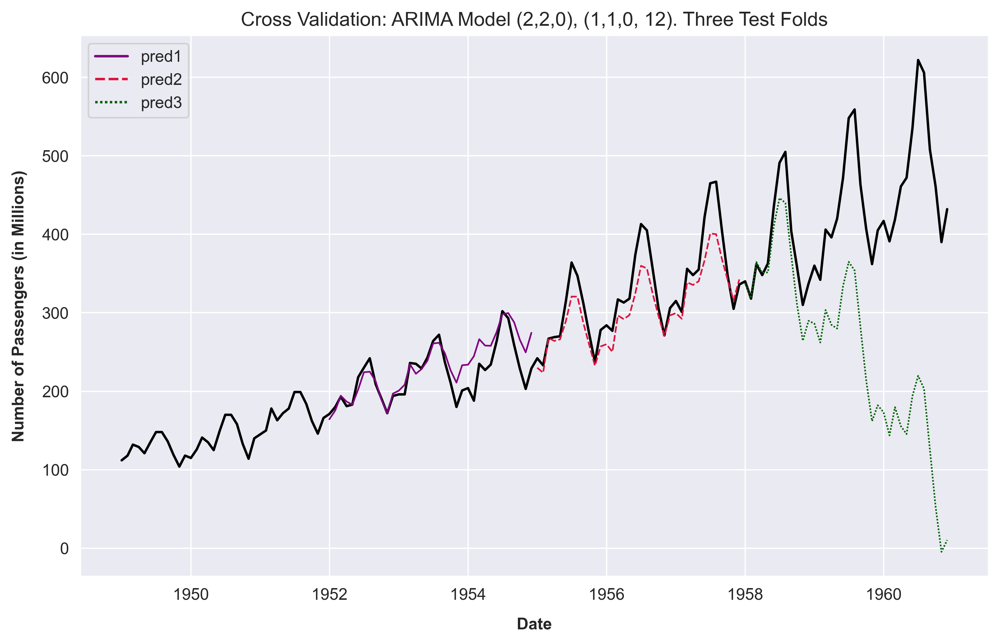

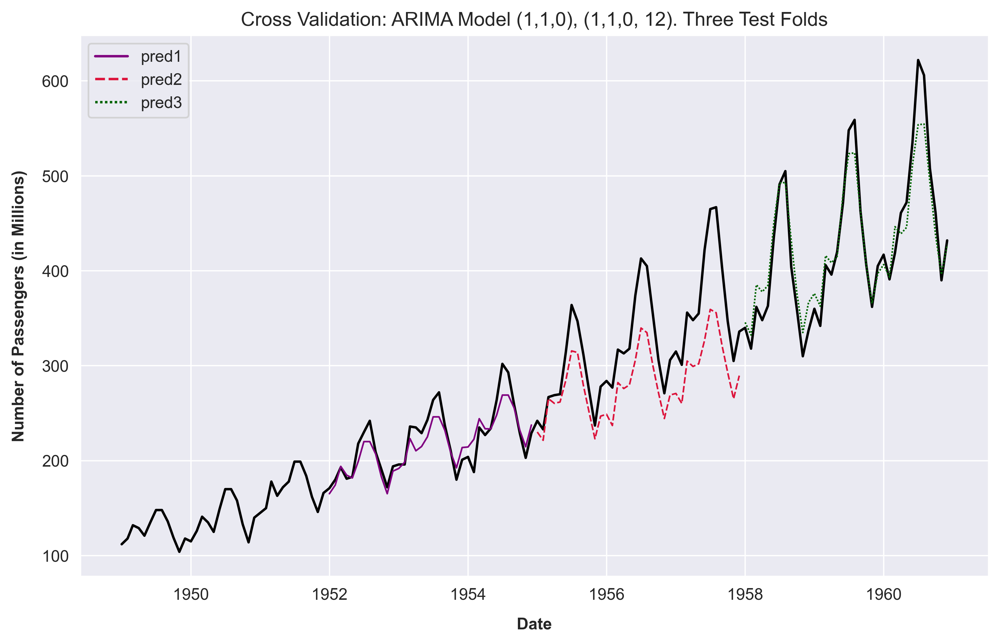

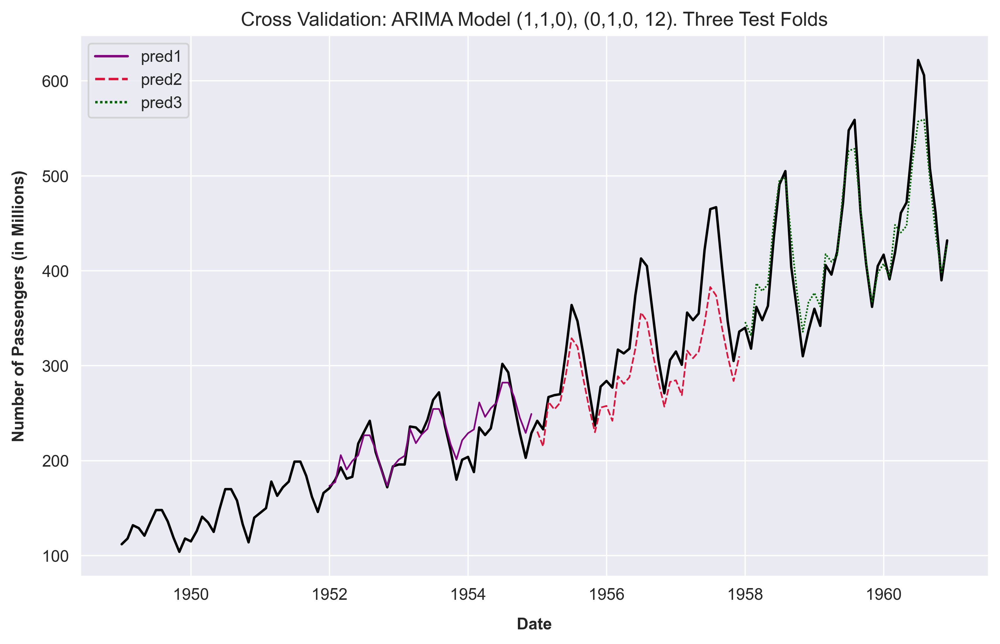

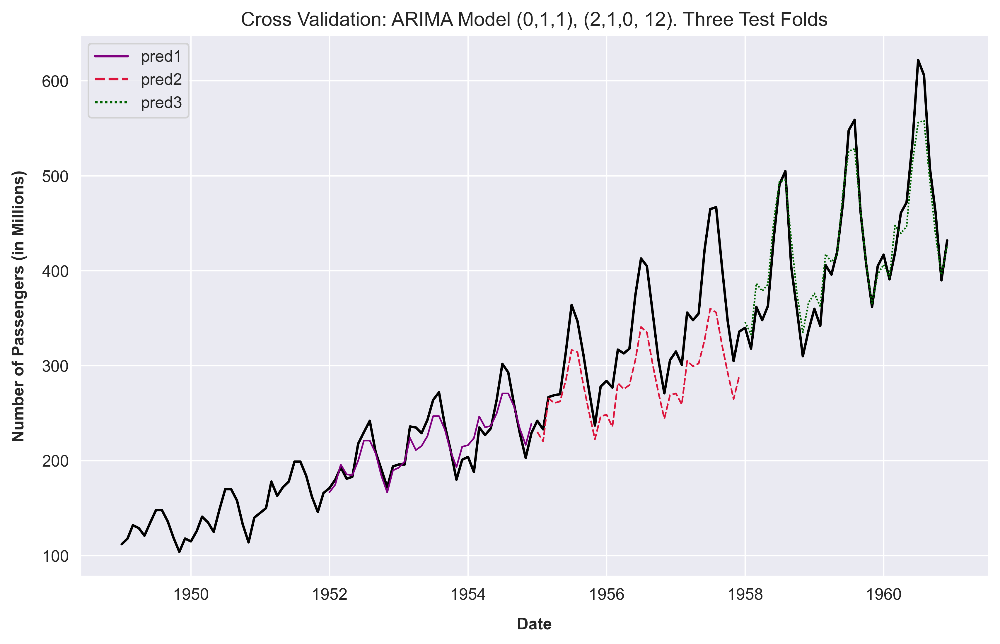

In [23]:
pred_set = [pred_1, pred_2, pred_3, pred_4]
mods = ['(2,2,0), (1,1,0, 12)', '(1,1,0), (1,1,0, 12)',
        '(1,1,0), (0,1,0, 12)', '(0,1,1), (2,1,0, 12)']

for i, j in zip(pred_set, mods):
    plt.figure(figsize=(10,6), dpi=400)

    sns.lineplot(data=df, x='date', y='passengers', color='black', linewidth=1.5)
    sns.lineplot(data=i.set_index('date')[['pred1','pred2', 'pred3']], 
                 linewidth=1,  palette=['purple', 'crimson', 'darkgreen'])

    plt.title('Cross Validation: ARIMA Model ' + j + '.' + ' Three Test Folds', size=12)
    plt.ylabel('Number of Passengers (in Millions)', size=10, weight='bold', labelpad=9)
    plt.xlabel('Date', size=10, weight='bold', labelpad=9)
    plt.show()

# 
### Now we will plot the different predictions for each split

[]

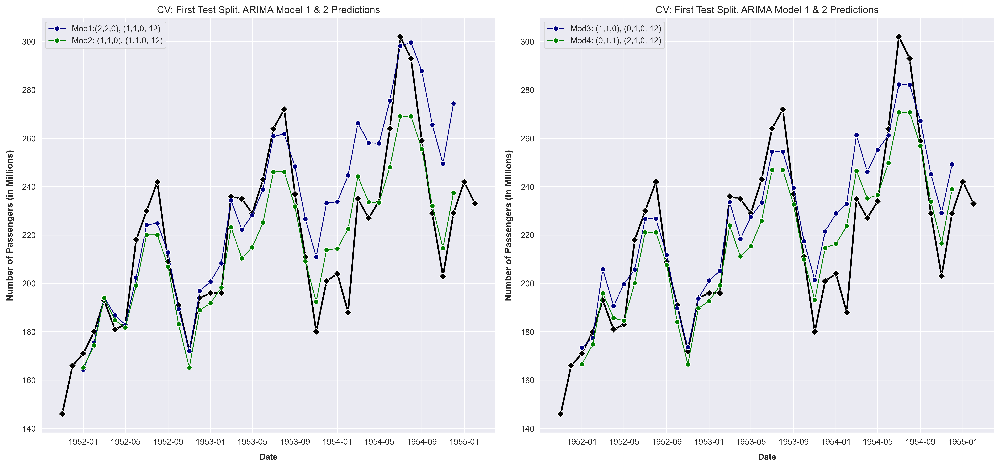

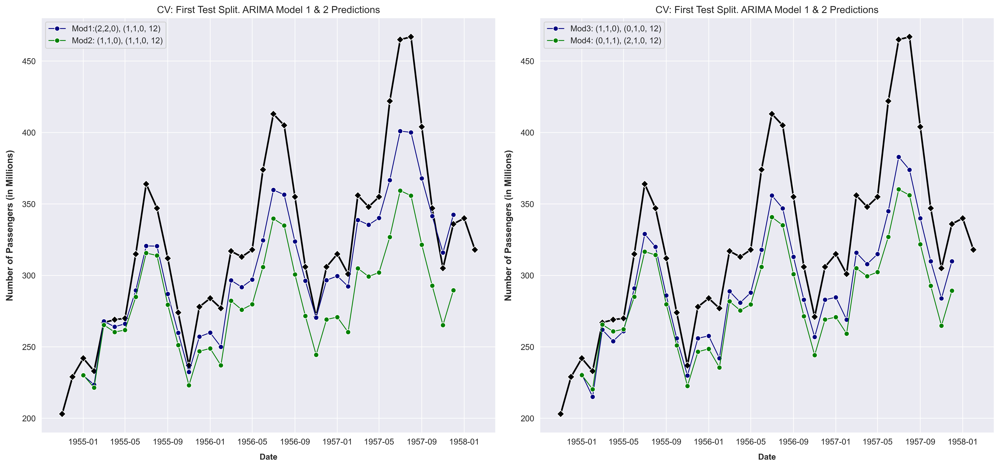

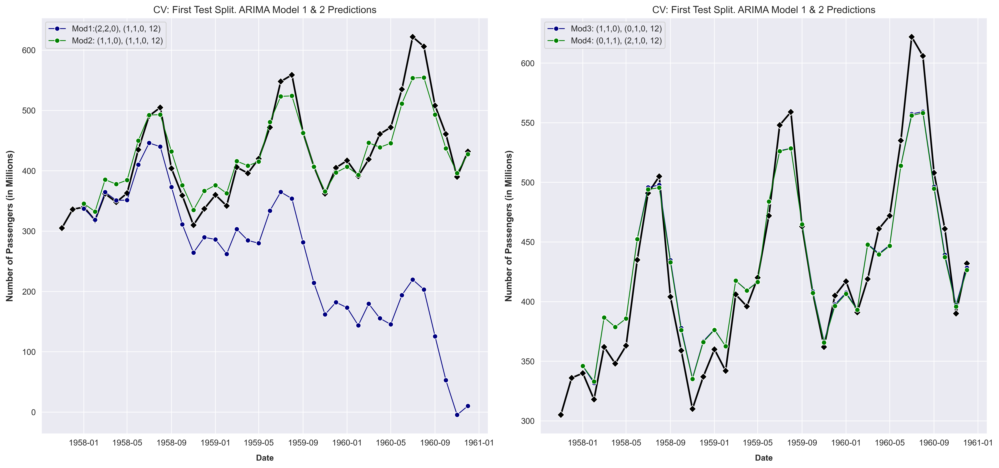

In [24]:
# First Split
plt.figure(figsize=(17,8), dpi=400)

plt.subplot(1,2,1)
sns.lineplot(data=df.loc[34:73], x='date', y='passengers', color='black', linewidth=2, marker='D')
sns.lineplot(data=pred_1, x='date', y='pred1', linewidth=1, marker='o', 
             color='navy', label='Mod1:(2,2,0), (1,1,0, 12)')
sns.lineplot(data=pred_2, x='date', y='pred1', linewidth=1, marker='o', 
             color='green', label='Mod2: (1,1,0), (1,1,0, 12)')
plt.title('CV: First Test Split. ARIMA Model 1 & 2 Predictions')
plt.ylabel('Number of Passengers (in Millions)', size=11, weight='bold', labelpad=9)
plt.xlabel('Date', size=10, weight='bold', labelpad=9)

plt.subplot(1,2,2)
sns.lineplot(data=df.loc[34:73], x='date', y='passengers', color='black', linewidth=2, marker='D')
sns.lineplot(data=pred_3, x='date', y='pred1', linewidth=1, marker='o',
            color='navy', label='Mod3: (1,1,0), (0,1,0, 12)')
sns.lineplot(data=pred_4, x='date', y='pred1', linewidth=1, marker='o',
            color='green', label='Mod4: (0,1,1), (2,1,0, 12)')
plt.title('CV: First Test Split. ARIMA Model 1 & 2 Predictions')
plt.ylabel('Number of Passengers (in Millions)', size=11, weight='bold', labelpad=9)
plt.xlabel('Date', size=10, weight='bold', labelpad=9)

plt.tight_layout()
plt.plot()

# Second Split #######################################
plt.figure(figsize=(17,8), dpi=400)

plt.subplot(1,2,1)
sns.lineplot(data=df.loc[70:109], x='date', y='passengers', color='black', linewidth=2, marker='D')
sns.lineplot(data=pred_1, x='date', y='pred2', linewidth=1, marker='o', 
             color='navy', label='Mod1:(2,2,0), (1,1,0, 12)')
sns.lineplot(data=pred_2, x='date', y='pred2', linewidth=1, marker='o', 
             color='green', label='Mod2: (1,1,0), (1,1,0, 12)')
plt.title('CV: First Test Split. ARIMA Model 1 & 2 Predictions')
plt.ylabel('Number of Passengers (in Millions)', size=11, weight='bold', labelpad=9)
plt.xlabel('Date', size=10, weight='bold', labelpad=9)

plt.subplot(1,2,2)
sns.lineplot(data=df.loc[70:109], x='date', y='passengers', color='black', linewidth=2, marker='D')
sns.lineplot(data=pred_3, x='date', y='pred2', linewidth=1, marker='o',
            color='navy', label='Mod3: (1,1,0), (0,1,0, 12)')
sns.lineplot(data=pred_4, x='date', y='pred2', linewidth=1, marker='o',
            color='green', label='Mod4: (0,1,1), (2,1,0, 12)')
plt.title('CV: First Test Split. ARIMA Model 1 & 2 Predictions')
plt.ylabel('Number of Passengers (in Millions)', size=11, weight='bold', labelpad=9)
plt.xlabel('Date', size=10, weight='bold', labelpad=9)

plt.tight_layout()
plt.plot()

# Third Split #######################################
plt.figure(figsize=(17,8), dpi=400)

plt.subplot(1,2,1)
sns.lineplot(data=df.loc[106:144], x='date', y='passengers', color='black', linewidth=2, marker='D')
sns.lineplot(data=pred_1, x='date', y='pred3', linewidth=1, marker='o', 
             color='navy', label='Mod1:(2,2,0), (1,1,0, 12)')
sns.lineplot(data=pred_2, x='date', y='pred3', linewidth=1, marker='o', 
             color='green', label='Mod2: (1,1,0), (1,1,0, 12)')
plt.title('CV: First Test Split. ARIMA Model 1 & 2 Predictions')
plt.ylabel('Number of Passengers (in Millions)', size=11, weight='bold', labelpad=9)
plt.xlabel('Date', size=10, weight='bold', labelpad=9)

plt.subplot(1,2,2)
sns.lineplot(data=df.loc[106:144], x='date', y='passengers', color='black', linewidth=2, marker='D')
sns.lineplot(data=pred_3, x='date', y='pred3', linewidth=1, marker='o',
            color='navy', label='Mod3: (1,1,0), (0,1,0, 12)')
sns.lineplot(data=pred_4, x='date', y='pred3', linewidth=1, marker='o',
            color='green', label='Mod4: (0,1,1), (2,1,0, 12)')
plt.title('CV: First Test Split. ARIMA Model 1 & 2 Predictions')
plt.ylabel('Number of Passengers (in Millions)', size=11, weight='bold', labelpad=9)
plt.xlabel('Date', size=10, weight='bold', labelpad=9)

plt.tight_layout()
plt.plot()

# 
### We're done for now. Later on, we'll do cross validation with other models and the same splits and we will compare the results.